In [6]:
# Data: https://humansintheloop.org/resources/datasets/car-parts-and-car-damages-dataset/

In [7]:
%matplotlib inline
from pycocotools.coco import COCO
#import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
#import pylab
#import random
#pylab.rcParams['figure.figsize'] = (8.0, 10.0)# Import Libraries

import datetime
# For visualization
import os
#import seaborn as sns
from matplotlib import colors
from tensorboard.backend.event_processing import event_accumulator as ea
#from PIL import Image


%matplotlib inline

#### Load data (Humans in the loop data)

In [39]:
import json

with open("data/humansintheloop/Carpartsdataset/File1/train/coco_annotations_damage.json", "r") as file:
    a_train = json.load(file)

with open("data/humansintheloop/Carpartsdataset/File1/val/coco_annotations_damage.json", "r") as file:
    a_val = json.load(file)


In [40]:
len([i["id"] for i in a_train["images"]]), len([i["file_name"] for i in a_train["images"]])

(662, 662)

In [41]:
len([i["id"] for i in a_val["images"]]), len([i["file_name"] for i in a_val["images"]])

(152, 152)

In [42]:
# initialize data paths
dataset_dir = "data/humansintheloop/Carpartsdataset/File1/"
img_dir = "img/"
train_dir = "train/"
val_dir = "val/"
test_dir = "test/"
test_dir = os.path.join("data/coco", test_dir)  # use test images from coco data set

img_dir = os.path.join(dataset_dir, img_dir)

# single class annotations: damage
ann_file_train = os.path.join(dataset_dir, train_dir, "coco_annotations_damage.json")
ann_file_val = os.path.join(dataset_dir, val_dir, "coco_annotations_damage.json")

# multi class annotations: headlamp, rear_bumper, door, hood, front_bumper
#ann_file_mul_val = os.path.join(dataset_dir, val_dir, "coco_annotations_damages.json")
#ann_file_mul_train = os.path.join(dataset_dir, train_dir, "coco_annotations_damages.json")

In [36]:
# tweak the annotations, add iscrowd: 0
_ = """
with open(ann_file_train, "r") as file:
    i = json.load(file)

for annotation in i["annotations"]:
    annotation["iscrowd"] = 0

with open(ann_file_train, "w") as f:
    json.dump(i, f, indent=4)
"""

In [12]:
# initialize coco api for instance annotations
coco=COCO(ann_file_train)
#mul_coco=COCO(ann_file_mul_val)

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!


In [13]:
# display categories and supercategories

#Single Class #Damage dataset
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO categories for damages: \n{}\n'.format(', '.join(nms)))

#Multi Class #Parts dataset

#mul_cats = mul_coco.loadCats(mul_coco.getCatIds())
#mul_nms=[cat['name'] for cat in mul_cats]
#print('COCO categories for parts: \n{}\n'.format(', '.join(mul_nms)))

COCO categories for damages: 
damage



# Model

In [9]:
# install detectron2
#!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

In [10]:
#!python -m pip install opencv-python
#!python -m pip install torch torchvision torchaudio

In [14]:
import detectron2
from detectron2.utils.logger import setup_logger

import torch, torchvision
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print(torch.__version__, torch.cuda.is_available())
print("detectron2:", detectron2.__version__)

1.13.1+cpu False
detectron2: 0.6


'nvcc' is not recognized as an internal or external command,
operable program or batch file.


In [15]:
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
import skimage.io as io

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Set base params
plt.rcParams["figure.figsize"] = [16,9]

In [44]:
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog
#DatasetCatalog.register("car_dataset_train_human4", 

register_coco_instances("car_dataset_train", {}, ann_file_train, image_root=img_dir)
register_coco_instances("car_dataset_val", {}, ann_file_val, image_root=img_dir)

In [19]:
dataset_dicts = DatasetCatalog.get("car_dataset_train")
metadata_dicts = MetadataCatalog.get("car_dataset_train")

[03/05 14:04:58 d2.data.datasets.coco]: Loaded 662 images in COCO format from data/humansintheloop/Carpartsdataset/File1/train/coco_annotations_damage.json


In [16]:
#[i for i in dataset_dicts if i['file_name']=='data/humansintheloop/Carpartsdataset/File1/img/Car damages 1069.png']

data/humansintheloop/Carpartsdataset/File1/img/Car damages 1159.png


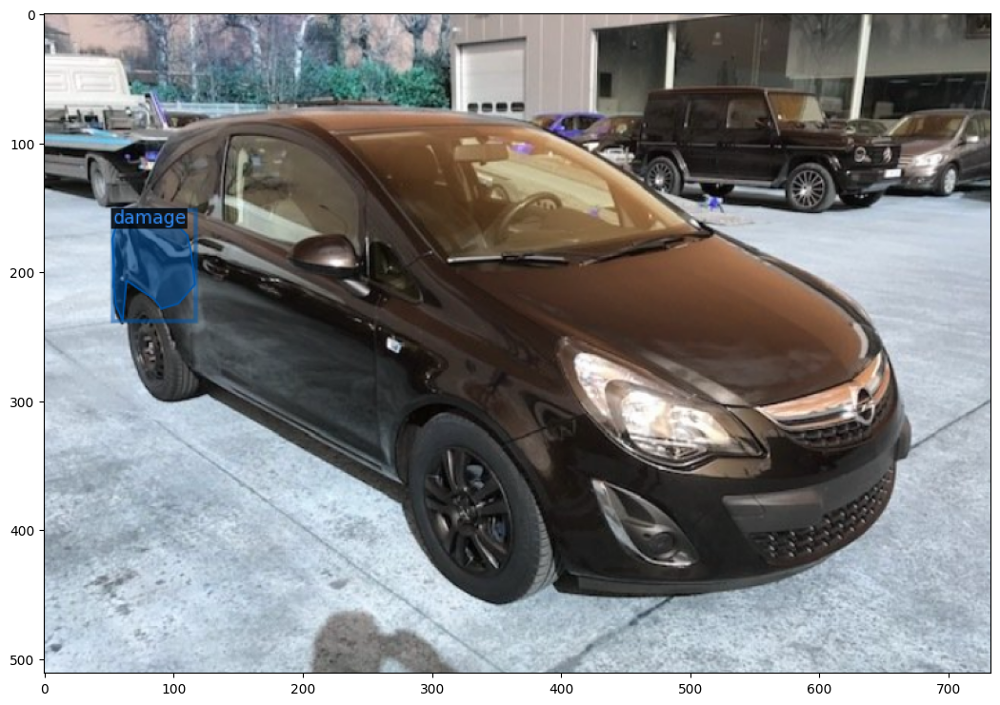

data/humansintheloop/Carpartsdataset/File1/img/Car damages 396.png


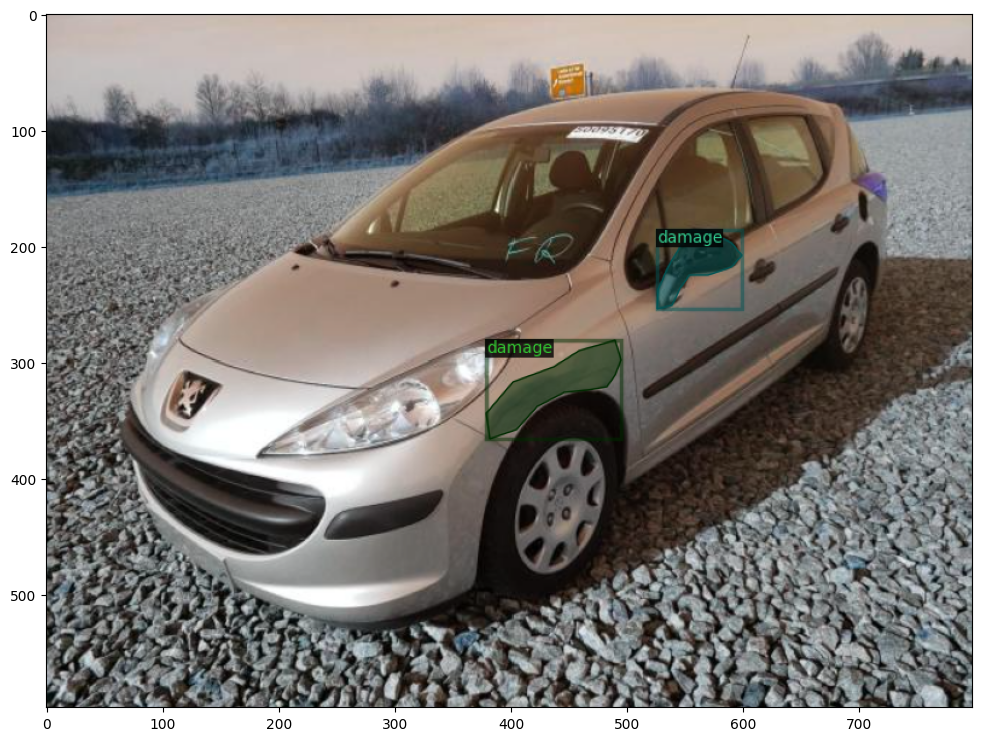

data/humansintheloop/Carpartsdataset/File1/img/Car damages 119.png


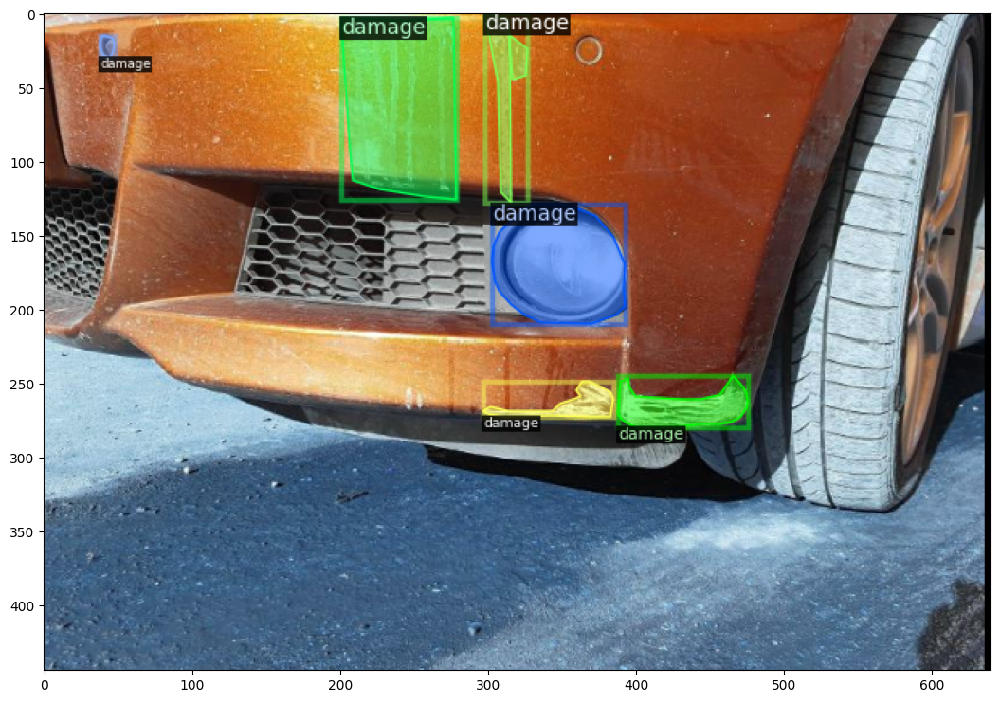

data/humansintheloop/Carpartsdataset/File1/img/Car damages 299.png


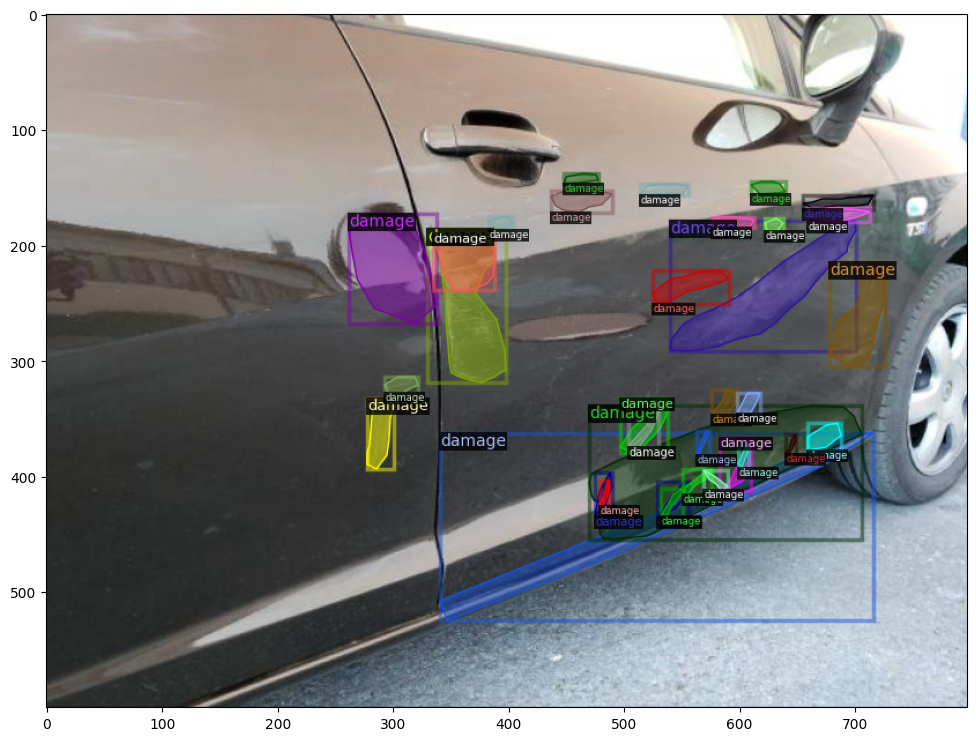

In [20]:
from cv2 import imshow
# To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:
#[i for i in dataset_dicts if i['file_name']=='data/humansintheloop/Carpartsdataset/File1/img/Car damages 1069.png']

for d in random.sample(dataset_dicts, 4):
    #print(d)
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata_dicts, scale=1)
    out = visualizer.draw_dataset_dict(d)
    #imshow("a", out.get_image()[:, :, ::-1])
    print(d["file_name"])
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()

## Train

In [56]:
cfg.OUTPUT_DIR

'./output/output_20240305_140555'

In [21]:
cfg = get_cfg()
cfg.OUTPUT_DIR = f"./output/output_{datetime.datetime.now().strftime('%Y%m%d_%T').replace(':', '')}"

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("car_dataset_train",)
cfg.DATASETS.TEST = ("car_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 4

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.MODEL.DEVICE='cpu'

cfg.SOLVER.IMS_PER_BATCH = 4  # 2,4    This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 300  # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []  # do not decay learning rate

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 8   # images used to calculate cls and reg loss during training. 128 is faster, and good enough for this  dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (damage)


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [22]:
# Add validation metrics to the tensorboard: https://github.com/ravijo/detectron2_tutorial/blob/main/main.py

from tfboard_validation.trainer import Trainer
from tfboard_validation.val_loss_hook import ValLossHook
from detectron2.engine import hooks


trainer = Trainer(cfg)

# creates a hook that after each iter calculates the validation loss on the next batch
# Register the hoooks
trainer.register_hooks([ValLossHook(cfg)])

# The PeriodicWriter needs to be the last hook, otherwise it wont have access to valloss metrics
# Ensure PeriodicWriter is the last called hook
periodic_writer_hook = [hook for hook in trainer._hooks if isinstance(hook, hooks.PeriodicWriter)]
all_other_hooks = [hook for hook in trainer._hooks if not isinstance(hook, hooks.PeriodicWriter)]
trainer._hooks = all_other_hooks + periodic_writer_hook


trainer.resume_or_load(resume=False)

# will throw error at the end (during the final evaluation). This is fine since I need to add "area" attribute into the annotations
trainer.train()

[03/05 14:06:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[03/05 14:06:04 d2.engine.train_loop]: Starting training from iteration 0


C:\Users\OBiloshytskyi\AppData\Local\anaconda3\envs\dl_model\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3191.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/05 14:12:05 d2.utils.events]:  eta: 1:05:15  iter: 19  total_loss: 5.785  loss_cls: 0.7885  loss_box_reg: 0.3993  loss_mask: 0.6937  loss_rpn_cls: 3.542  loss_rpn_loc: 0.3461  val_total_loss: 5.556  val_loss_cls: 0.799  val_loss_box_reg: 0.3109  val_loss_mask: 0.6934  val_loss_rpn_cls: 3.303  val_loss_rpn_loc: 0.3802    time: 14.7258  last_time: 15.1345  data_time: 0.1272  last_data_time: 0.0037   lr: 1.6068e-05  
[03/05 14:18:10 d2.utils.events]:  eta: 1:03:22  iter: 39  total_loss: 3.814  loss_cls: 0.674  loss_box_reg: 0.3955  loss_mask: 0.6883  loss_rpn_cls: 1.603  loss_rpn_loc: 0.3141  val_total_loss: 3.552  val_loss_cls: 0.6764  val_loss_box_reg: 0.4179  val_loss_mask: 0.6877  val_loss_rpn_cls: 1.347  val_loss_rpn_loc: 0.3348    time: 14.8256  last_time: 13.3109  data_time: 0.0031  last_data_time: 0.0040   lr: 3.2718e-05  
[03/05 14:24:18 d2.utils.events]:  eta: 0:58:42  iter: 59  total_loss: 2.548  loss_cls: 0.5928  loss_box_reg: 0.547  loss_mask: 0.6764  loss_rpn_cls: 0.3762

KeyError: 'iscrowd'

In [48]:
# Look at training curves in tensorboard:
#tensorboard --logdir output
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 32088), started 0:02:17 ago. (Use '!kill 32088' to kill it.)

# Inference & evaluation using the trained model

#### Now, let's run inference with the trained model on the validation dataset. First, let's create a predictor using the model we just trained:

In [50]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[03/06 14:04:58 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/output_20240305_140555\model_final.pth ...


#### Then, we randomly select several samples to visualize the prediction results on validation data

In [51]:
dataset_val_dicts = DatasetCatalog.get("car_dataset_val")
metadata_val_dicts = MetadataCatalog.get("car_dataset_val")

[03/06 14:05:08 d2.data.datasets.coco]: Loaded 152 images in COCO format from data/humansintheloop/Carpartsdataset/File1/val/coco_annotations_damage.json


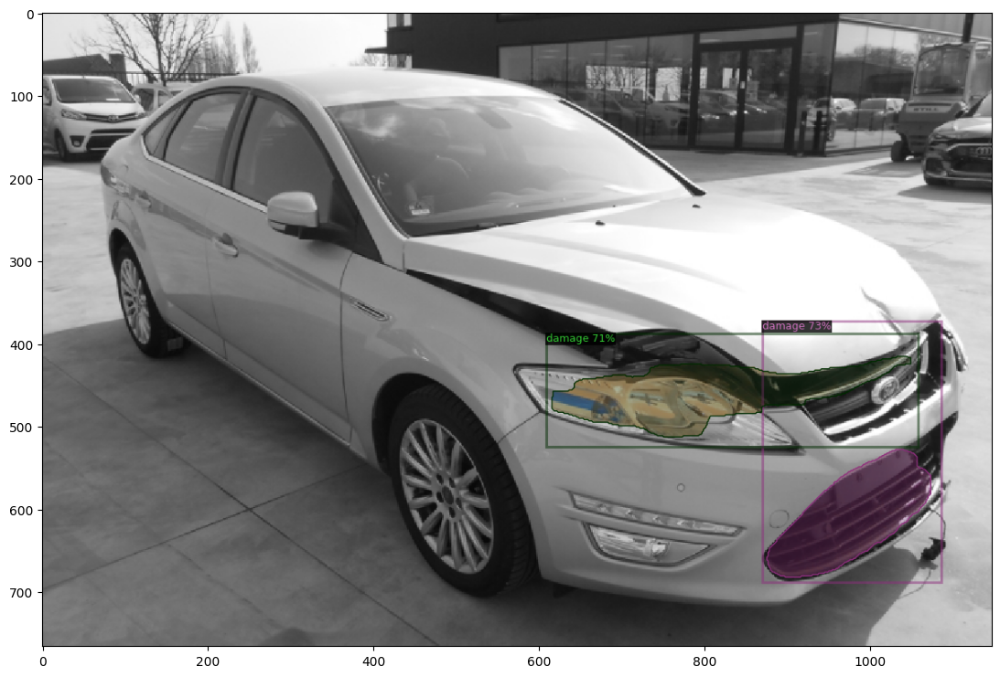

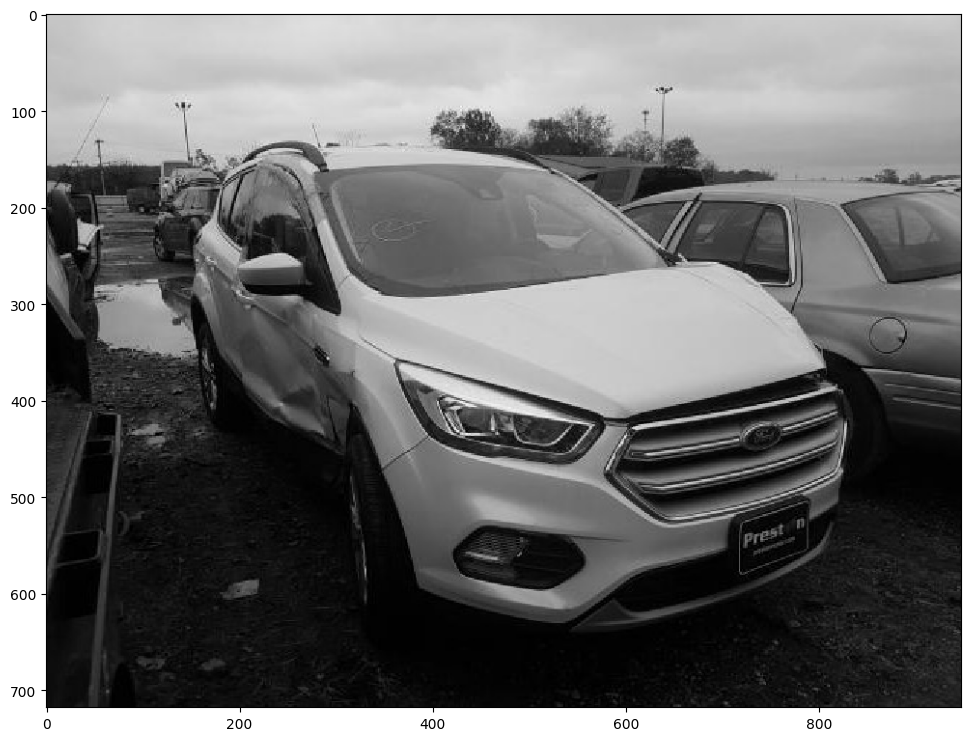

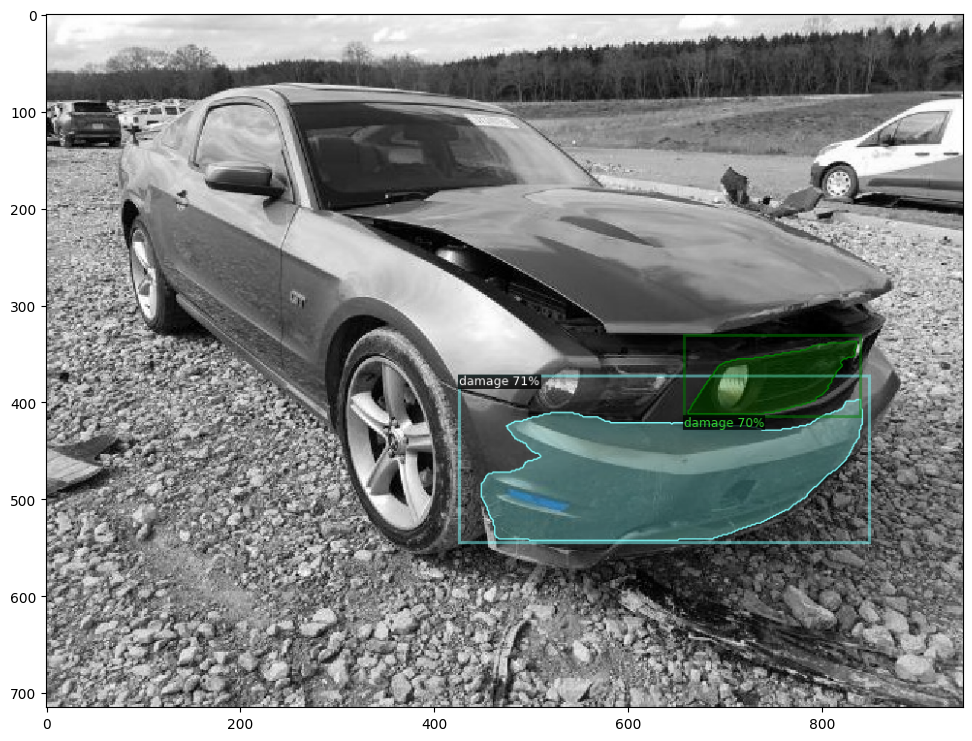

In [53]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_val_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata_val_dicts, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    #cv2_imshow(out.get_image()[:, :, ::-1])
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()

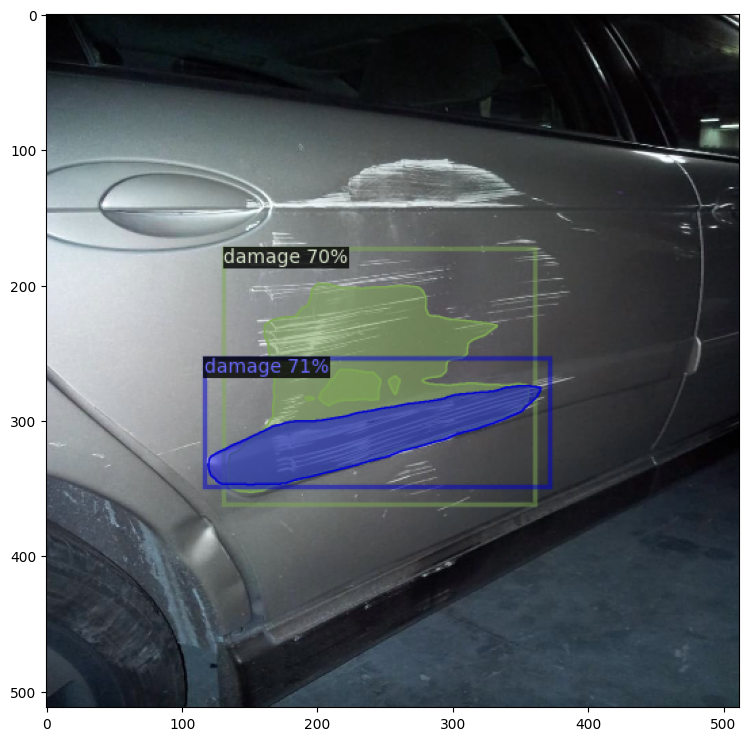

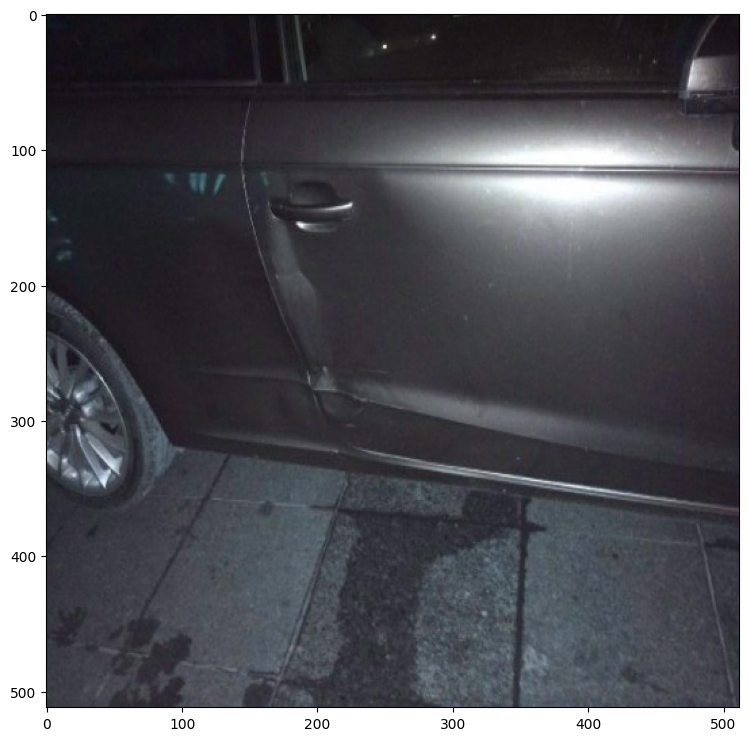

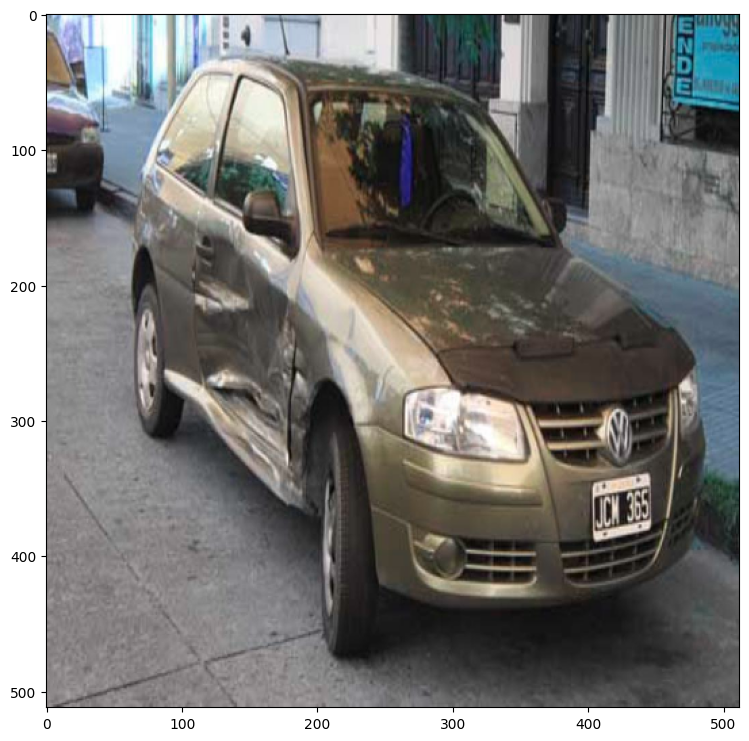

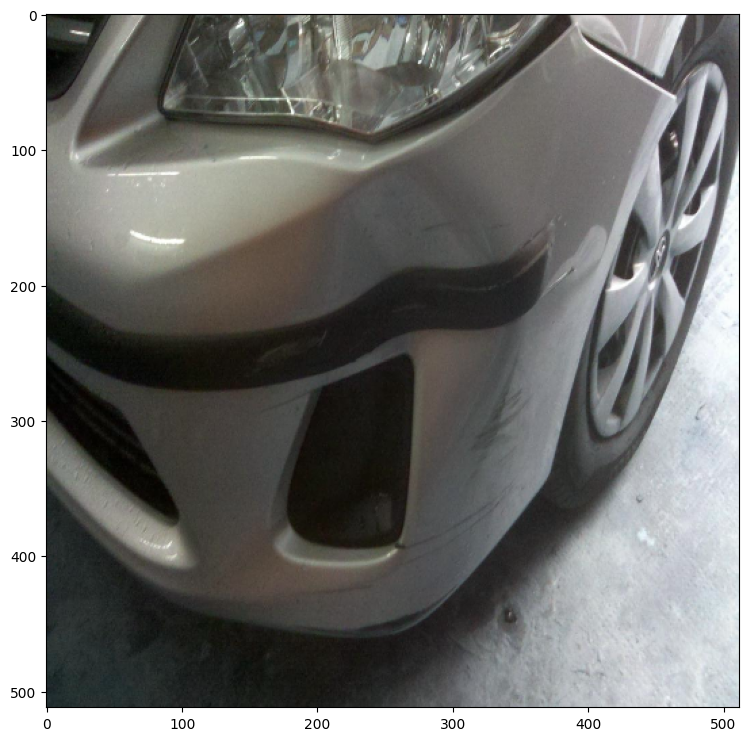

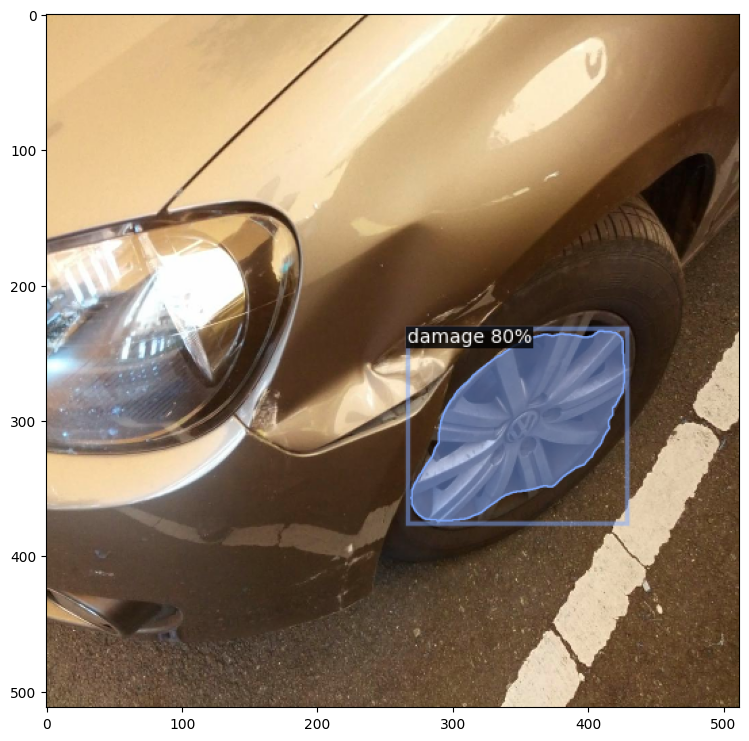

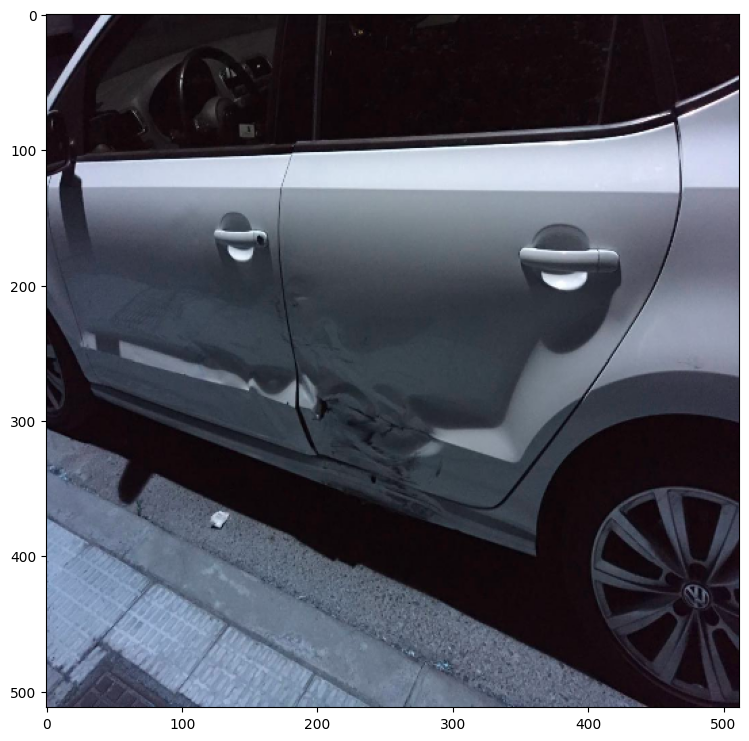

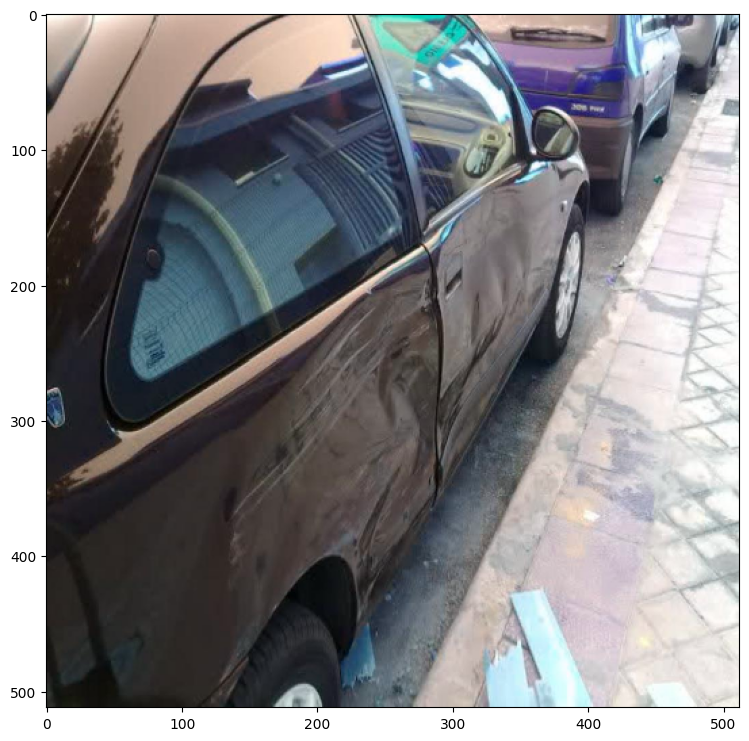

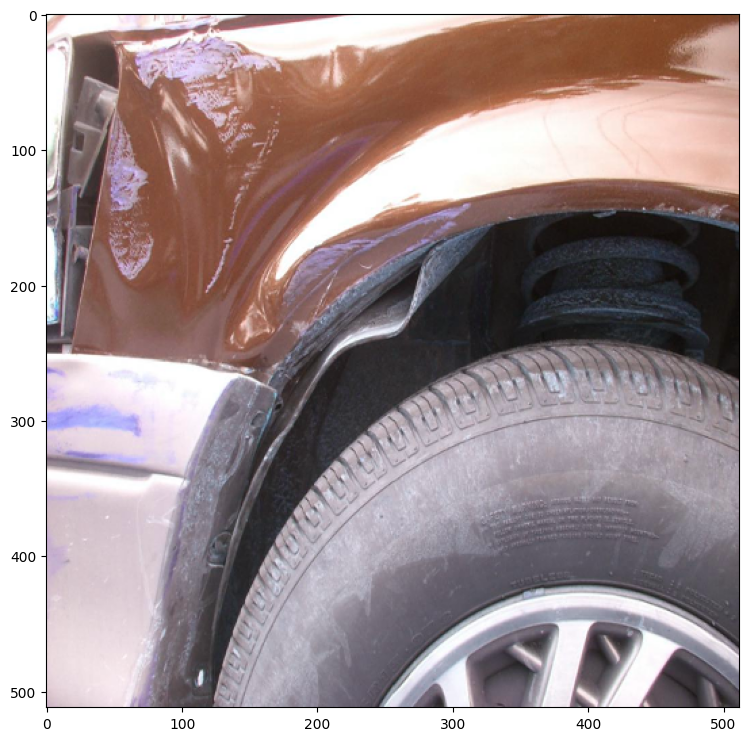

In [55]:
# Check the model on test data

import glob

for img in glob.glob(f'{test_dir}*.jpg'):
  im = cv2.imread(img)
  #print(im)
  output = predictor(im)
  #plt.imshow(im)
  #plt.show()
  #print(output)

  # We can use `Visualizer` to draw the predictions on the test images
  v = Visualizer(im[:, :, ::-1], metadata_dicts, scale=0.5)
  out = v.draw_instance_predictions(output["instances"].to("cpu"))
  #cv2_imshow(out.get_image()[:, :, ::-1])
  plt.imshow(out.get_image()[:, :, ::-1])
  plt.show()

#### We can also evaluate its performance using AP metric implemented in COCO API. This gives an AP of ~5.

In [ ]:
# Will fail, as there is no "area" in annotations
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("car_dataset_val", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "car_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

# Continue training on coco data (WIP)

In [91]:
# coco data
# initialize data paths
dataset_coco_dir = "data/coco/"
img_coco_dir = "img/"
train_coco_dir = "train/"
val_coco_dir = "val/"

# test dir is the same
#test_dir = "test/"
#test_dir = os.path.join(dataset_dir, test_dir)

img_coco_dir = os.path.join(dataset_coco_dir, img_coco_dir)

# single class annotations: damage
ann_coco_train = os.path.join(dataset_coco_dir, train_coco_dir, "COCO_train_annos.json")
ann_coco_val = os.path.join(dataset_coco_dir, val_coco_dir, "COCO_val_annos.json")

In [93]:
# register data
from detectron2.data.datasets import register_coco_instances
register_coco_instances("coco_car_dataset_train2", {}, ann_coco_train, img_coco_dir)
register_coco_instances("coco_car_dataset_val2", {}, ann_coco_val, img_coco_dir)

dataset_coco_dicts = DatasetCatalog.get("coco_car_dataset_train2")
metadata_coco_dicts = MetadataCatalog.get("coco_car_dataset_train2")

[03/06 15:58:26 d2.data.datasets.coco]: Loaded 59 images in COCO format from data/coco/train/COCO_train_annos.json


In [114]:
#print(cfg)

In [126]:
# upd config
cfg = get_cfg()
cfg.OUTPUT_DIR = './output/output_20240305_140555'  # load model from the last checkpoint
cfg.DATASETS.TRAIN = ("coco_car_dataset_train2",)
cfg.DATASETS.TEST = ("coco_car_dataset_val2",)
#cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.DEVICE='cpu'

cfg.SOLVER.IMS_PER_BATCH = 2  # 2,4    This is the real "batch size" commonly known to deep learning people
#cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 300  # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []  # do not decay learning rate

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 8   # images used to calculate cls and reg loss during training. 128 is faster, and good enough for this  dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (damage)


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [120]:
cfg["DATASETS"]["TEST"]

('coco_car_dataset_val2',)

In [127]:
trainer = Trainer(cfg)

# creates a hook that after each iter calculates the validation loss on the next batch
# Register the hoooks
trainer.register_hooks([ValLossHook(cfg)])

# The PeriodicWriter needs to be the last hook, otherwise it wont have access to valloss metrics
# Ensure PeriodicWriter is the last called hook
periodic_writer_hook = [hook for hook in trainer._hooks if isinstance(hook, hooks.PeriodicWriter)]
all_other_hooks = [hook for hook in trainer._hooks if not isinstance(hook, hooks.PeriodicWriter)]
trainer._hooks = all_other_hooks + periodic_writer_hook

trainer.resume_or_load(resume=False)

[03/06 16:46:32 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

In [128]:
# will throw error at the end (during the final evaluation). This is fine since I need to add "area" attribute into the annotations
trainer.train()

[03/06 16:46:39 d2.engine.train_loop]: Starting training from iteration 0
[03/06 16:51:29 d2.utils.events]:  eta: 0:34:49  iter: 19  total_loss: 165.1  loss_cls: 148.3  loss_box_reg: 12.7  loss_rpn_cls: 1.766  loss_rpn_loc: 2.825  val_total_loss: 134  val_loss_cls: 121.3  val_loss_box_reg: 8.523  val_loss_rpn_cls: 1.857  val_loss_rpn_loc: 2.473    time: 10.6703  last_time: 19.0991  data_time: 0.2245  last_data_time: 0.0014   lr: 6.427e-05  
[03/06 16:54:33 d2.utils.events]:  eta: 0:25:34  iter: 39  total_loss: 5.183  loss_cls: 2.331  loss_box_reg: 0.9318  loss_rpn_cls: 0.6793  loss_rpn_loc: 0.7934  val_total_loss: 5.106  val_loss_cls: 2.573  val_loss_box_reg: 1.001  val_loss_rpn_cls: 0.6664  val_loss_rpn_loc: 0.6983    time: 8.1285  last_time: 5.8272  data_time: 0.0015  last_data_time: 0.0016   lr: 0.00013087  
[03/06 17:24:34 d2.utils.events]:  eta: 0:23:28  iter: 59  total_loss: 1.716  loss_cls: 0.65  loss_box_reg: 0.7511  loss_rpn_cls: 0.3305  loss_rpn_loc: 0.1021  val_total_loss: 2

# Verify on validation data

In [129]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[03/07 10:05:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/output_20240305_140555\model_final.pth ...


In [130]:

dataset_coco_dicts = DatasetCatalog.get("coco_car_dataset_val2")
metadata_coco_dicts = MetadataCatalog.get("coco_car_dataset_val2")

[03/07 10:06:05 d2.data.datasets.coco]: Loaded 11 images in COCO format from data/coco/val/COCO_val_annos.json


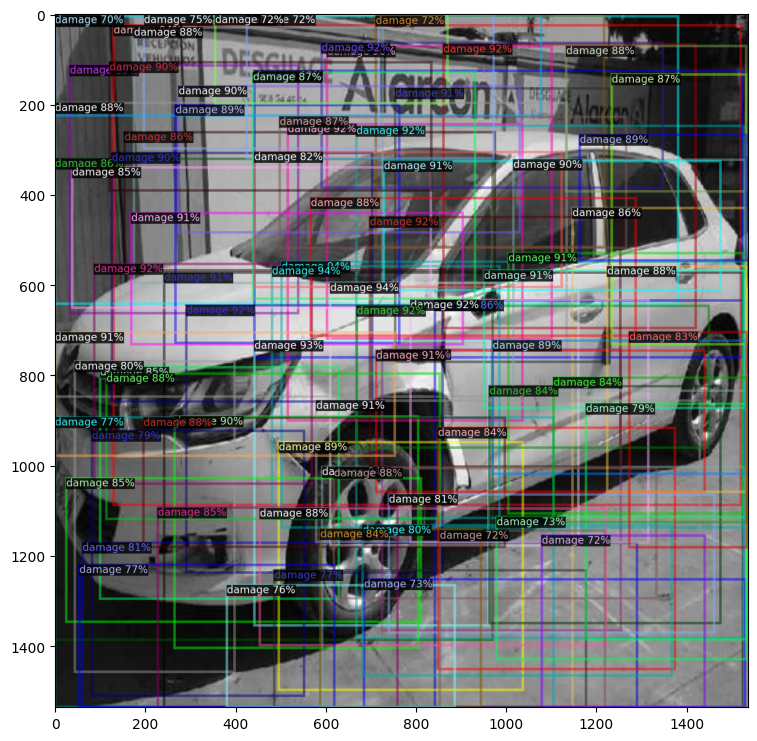

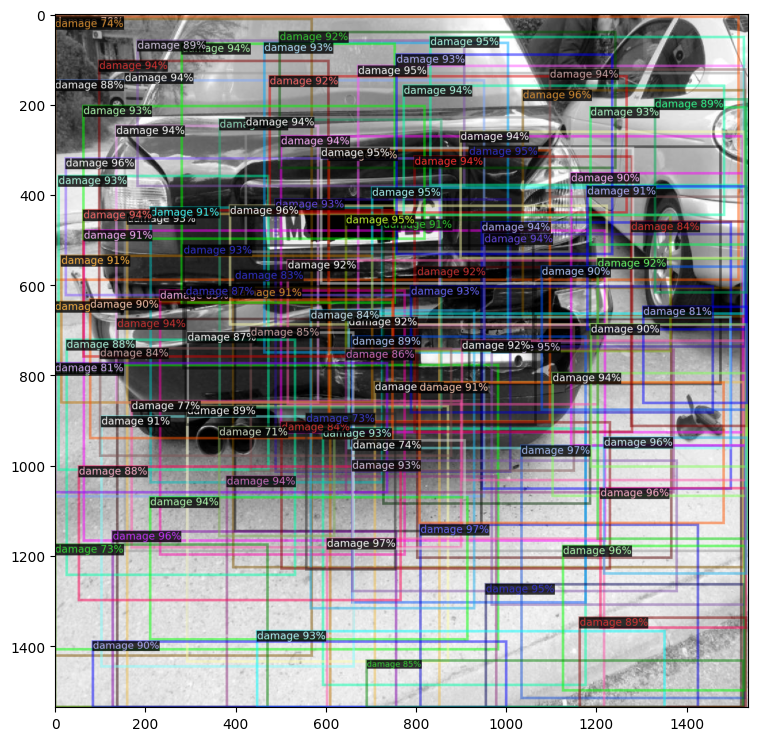

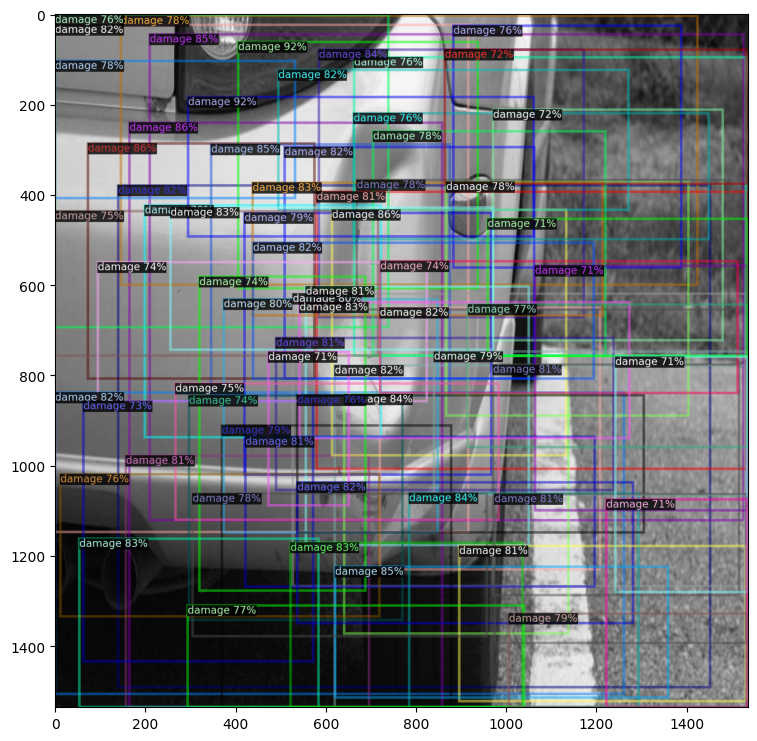

In [132]:
from detectron2.utils.visualizer import ColorMode
#dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_coco_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata_coco_dicts, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    #cv2_imshow(out.get_image()[:, :, ::-1])
    plt.imshow(out.get_image()[:, :, ::-1])
    plt.show()

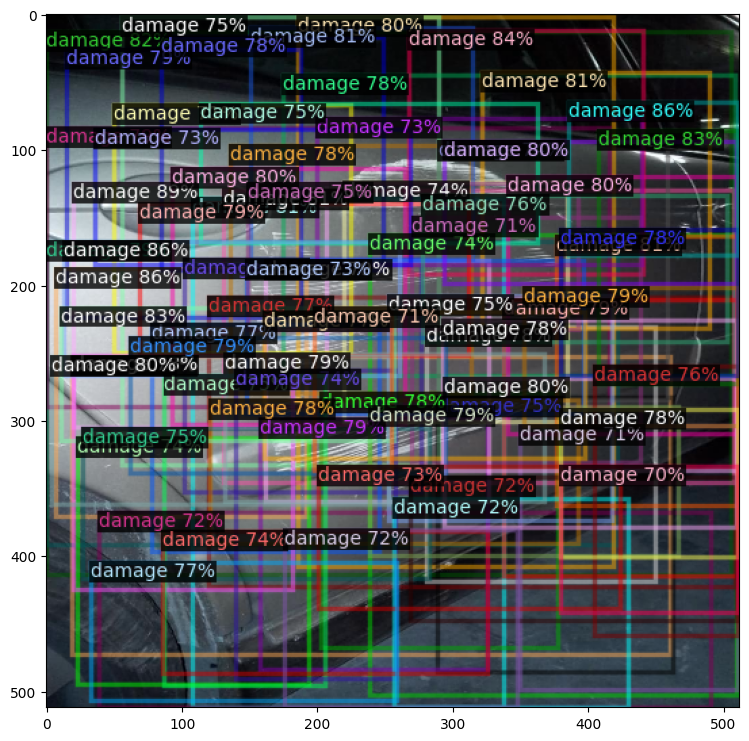

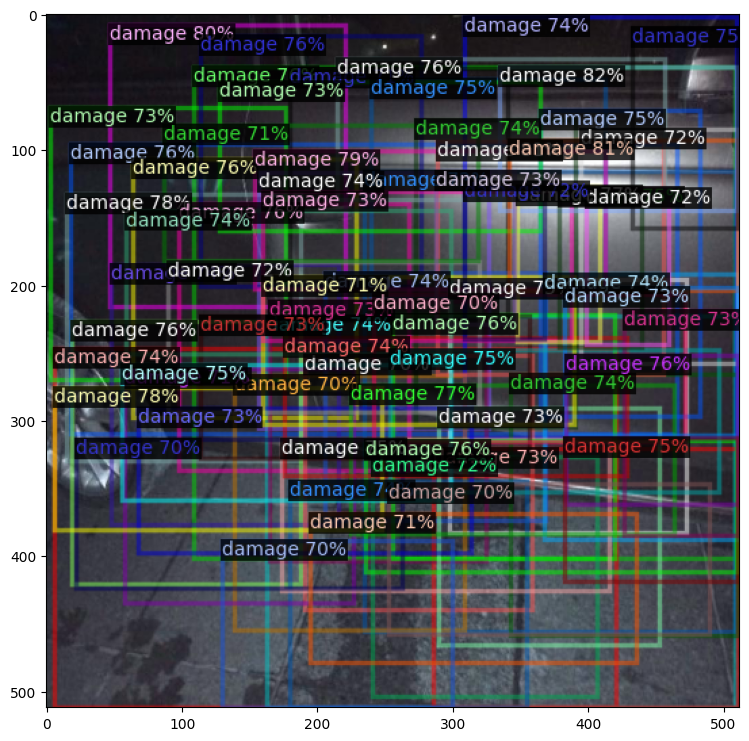

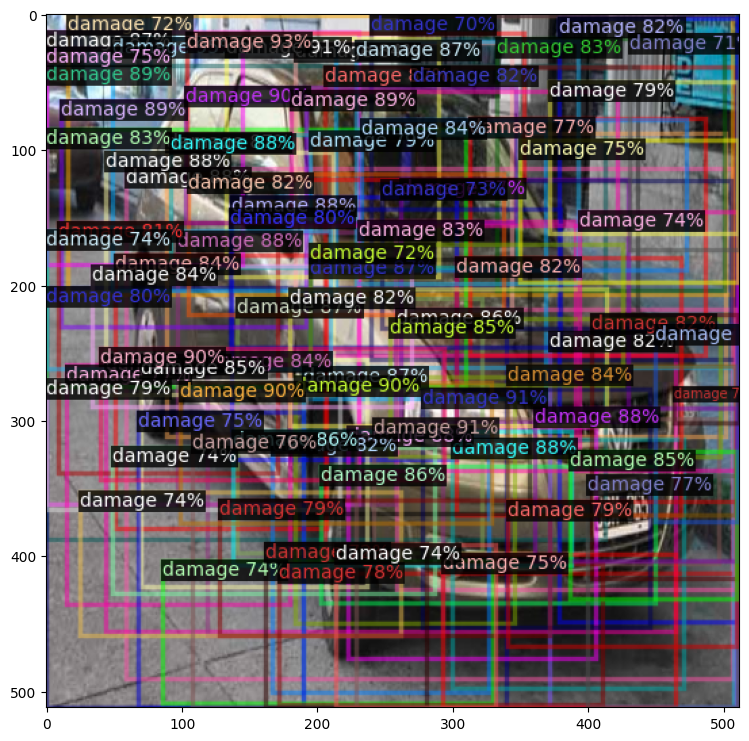

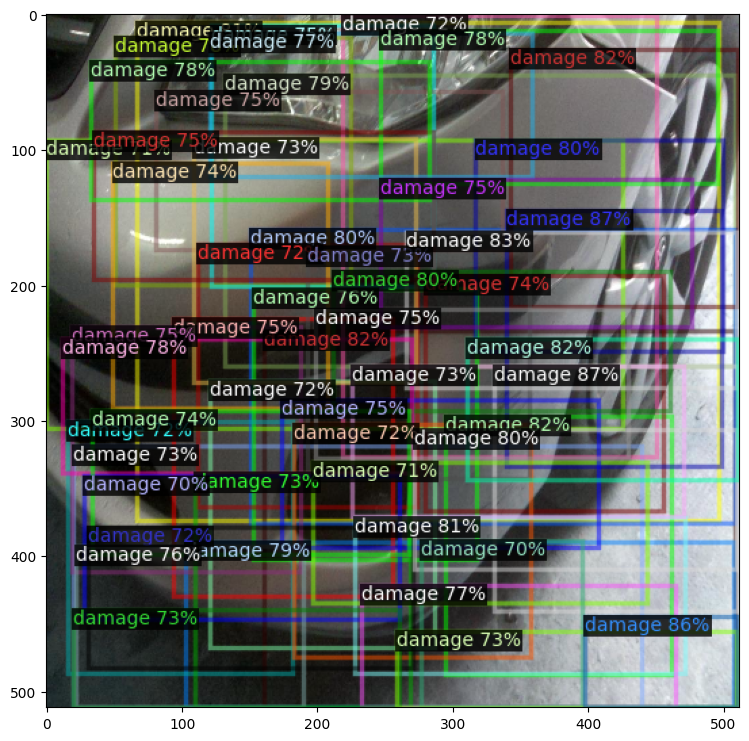

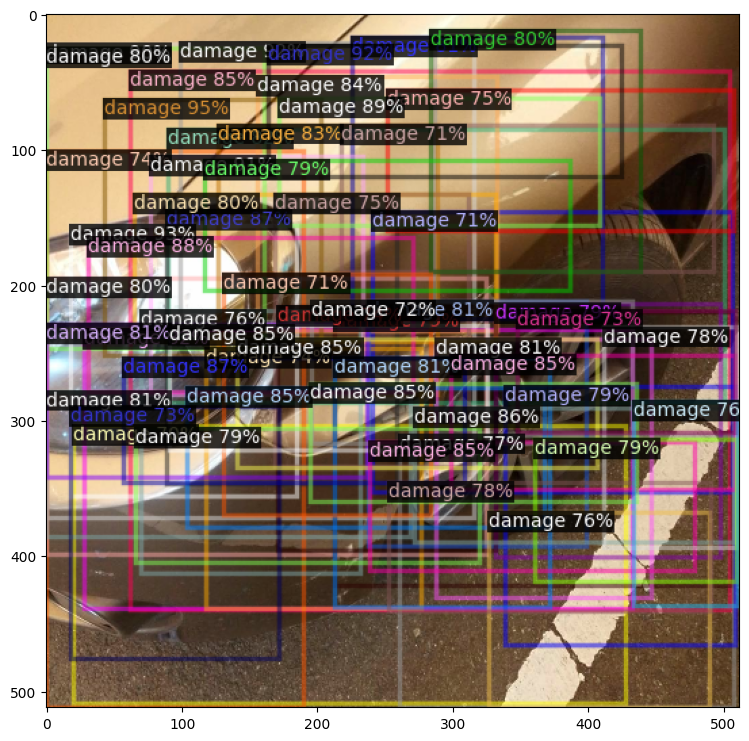

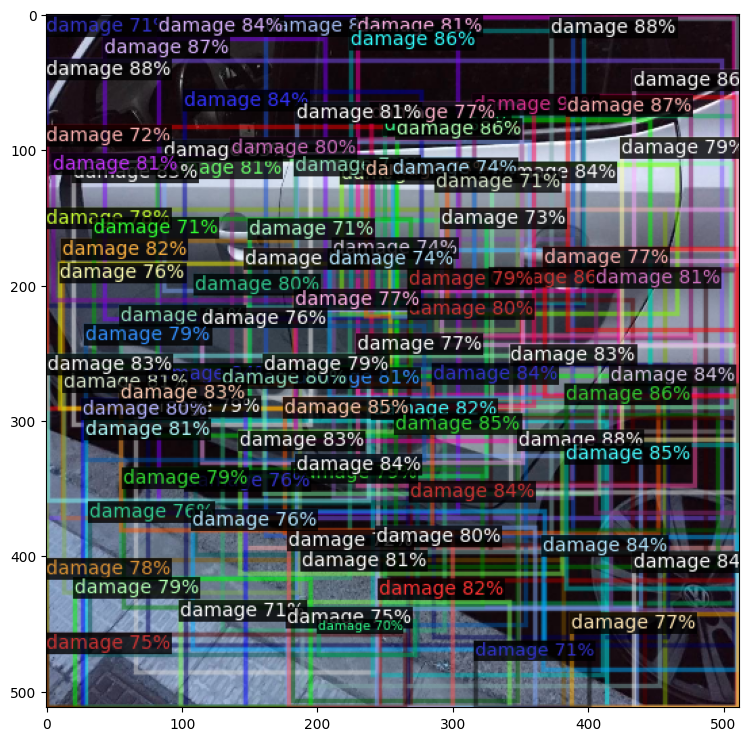

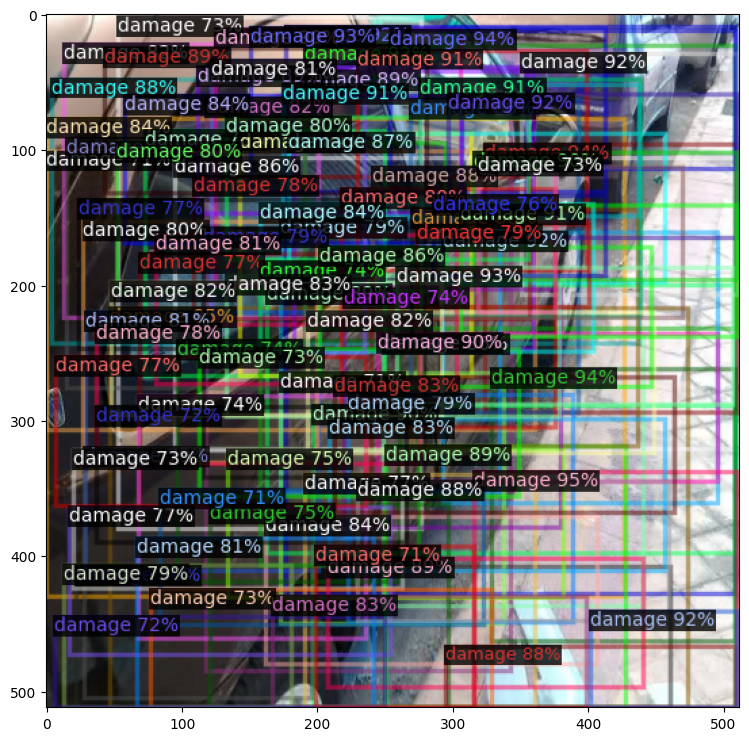

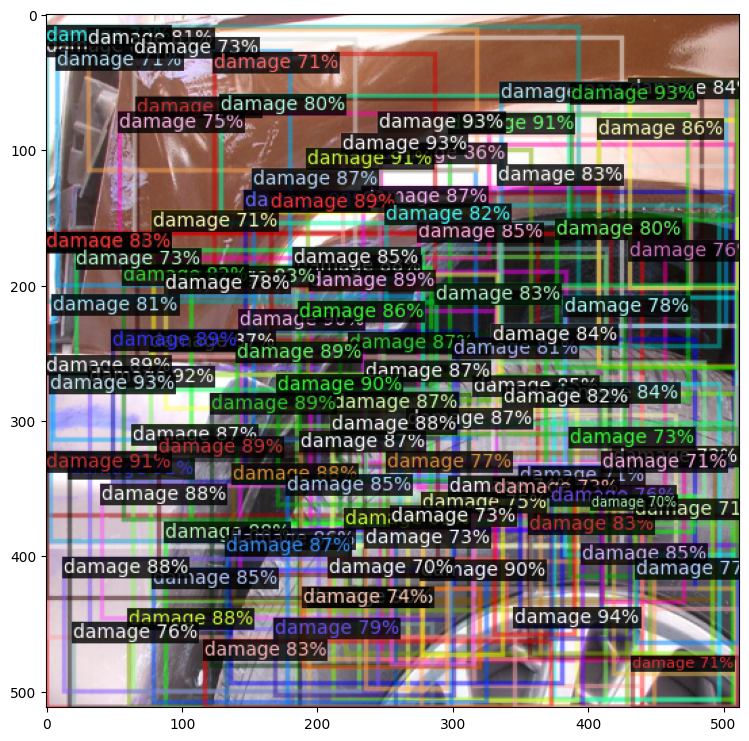

In [133]:
# Check the model on test data

import glob

for img in glob.glob(f'{test_dir}*.jpg'):
  im = cv2.imread(img)
  #print(im)
  output = predictor(im)
  #plt.imshow(im)
  #plt.show()
  #print(output)

  # We can use `Visualizer` to draw the predictions on the test images
  v = Visualizer(im[:, :, ::-1], metadata_dicts, scale=0.5)
  out = v.draw_instance_predictions(output["instances"].to("cpu"))
  #cv2_imshow(out.get_image()[:, :, ::-1])
  plt.imshow(out.get_image()[:, :, ::-1])
  plt.show()